In [1]:
import bokeh
from bokeh.plotting import figure, show, ColumnDataSource, save
from bokeh.embed import components
from bokeh.io import output_notebook
from bokeh.models import FactorRange, HoverTool, ColumnDataSource, Panel
from bokeh.models.widgets import CheckboxGroup, Slider, RangeSlider, Tabs

from bokeh.layouts import column, row, WidgetBox
from bokeh.palettes import viridis

from bokeh.application.handlers import FunctionHandler
from bokeh.application import Application

In [2]:
import pandas as pd
import numpy as np
import geopandas as gpd
import os
from os.path import join
from shapely.geometry import Polygon
from matplotlib import pyplot
%matplotlib inline

In [3]:
os.chdir('Data/')
os.getcwd()

'C:\\Users\\karan\\Python Notebooks\\MPI\\Data'

In [4]:
all_shp = gpd.read_file('all_cts.shp')
all_shp['GEOID'] = pd.to_numeric(all_shp['GEOID'])
all_shp.head()

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,06,001,400600,1400000US06001400600,6001400600,4006,CT,297856,0,"POLYGON ((-122.26807 37.844136, -122.26514 37...."
1,06,001,400900,1400000US06001400900,6001400900,4009,CT,420877,0,"POLYGON ((-122.285576 37.839778, -122.283186 3..."
2,06,001,401400,1400000US06001401400,6001401400,4014,CT,758204,0,"POLYGON ((-122.278611 37.826878, -122.268563 3..."
3,06,001,403000,1400000US06001403000,6001403000,4030,CT,352394,0,"POLYGON ((-122.274757 37.79883299999999, -122...."
4,06,001,405902,1400000US06001405902,6001405902,4059.02,CT,487280,0,"POLYGON ((-122.247175 37.789913, -122.243512 3..."


In [5]:
all_tag = pd.read_csv('all_tag.csv',usecols=['origin_lat','origin_lng','dest_lat','dest_lng','od_counts','city'])

In [6]:
all_tag.head()

,origin_lat,origin_lng,dest_lat,dest_lng,od_counts,city
0,35.271213,-119.003879,35.212169,-117.879627,2,la
1,35.271213,-119.003879,33.862030,-118.379133,2,la
2,35.271213,-119.003879,33.767114,-118.374795,1,la
3,35.271213,-119.003879,33.785758,-118.378023,1,la
4,35.271213,-119.003879,34.101624,-118.625216,3,la


In [7]:
all_tag['city'].unique()

array(['la', 'sf'], dtype=object)

Text(0.5, 1.0, 'San Francisco')

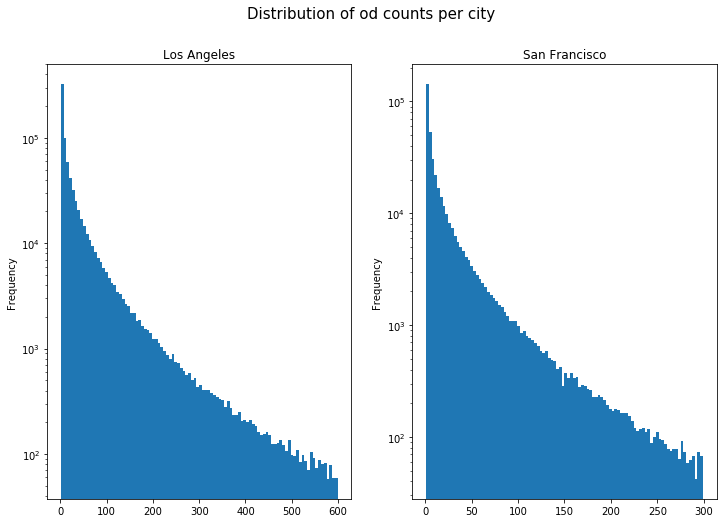

In [8]:
fig, axes = pyplot.subplots(ncols=2, nrows=1, figsize=(12,8))

all_tag[(all_tag['city']=='la')&(all_tag['od_counts']<600)].od_counts.plot(ax=axes[0],kind='hist',bins=100,logy=True)
all_tag[(all_tag['city']=='sf')&(all_tag['od_counts']<300)].od_counts.plot(ax=axes[1],kind='hist',bins=100,logy=True)

fig.suptitle("Distribution of od counts per city",fontsize=15)
axes[0].set_title('Los Angeles')
axes[1].set_title('San Francisco')

In [9]:
# Get the number of colors we'll need for the plot.
colors = ['darkred','orange','yellow','green']
# Create a map between factor and color.
colormap = {i: colors[i] for i in range(len(colors))}

bins = [0,50,100,1000,100000]
labels = np.arange(1,len(bins))

all_tag['binned'] = pd.cut(all_tag['od_counts'], bins=bins, labels=labels)
all_tag['color'] = all_tag['binned'].map(lambda x: colormap[3-(x-1)])

In [10]:
all_tag_source = ColumnDataSource(all_tag[(all_tag['color']!='green')&(all_tag['color']!='yellow')])

In [11]:
def getPolyCoords(row, geom, coord_type):
    """Returns the coordinates ('x' or 'y') of edges of a Polygon exterior"""
    
    # Parse the exterior of the coordinate
    try:
        exterior = row[geom].exterior
    except:
        exterior = row[geom][0].exterior
    if coord_type == 'x':
        # Get the x coordinates of the exterior
        return list( exterior.coords.xy[0] )
    elif coord_type == 'y':
        # Get the y coordinates of the exterior
        return list( exterior.coords.xy[1] )

In [12]:
all_shp['x'] = all_shp.apply(getPolyCoords, geom='geometry', coord_type='x', axis=1)
all_shp['y'] = all_shp.apply(getPolyCoords, geom='geometry', coord_type='y', axis=1)

In [13]:
all_shp_source = ColumnDataSource(all_shp[['x','y']])

In [14]:
output_notebook()

Loading BokehJS ...

In [15]:
p = figure(plot_width = 700, plot_height = 600, title = 'OD counts arc map')

p.patches(xs='x', ys='y', source=all_shp_source, fill_alpha=0.25,line_width=0.01)

p.segment(x0='origin_lng', y0='origin_lat', x1='dest_lng', y1='dest_lat', source=all_tag_source, color={'field':'color'}, line_width=0.1)

show(p)

# Static Screenshot

<img src="Bokeh_Arc_Map.png">